<a href="https://colab.research.google.com/github/kasheekeswani/Sales_Forecasting/blob/main/Sales.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<ipython-input-3-7ff27d15dd4c>:9: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  df_sales = pd.read_csv("/content/train.csv", on_bad_lines='skip', encoding="utf-8")


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 18 columns):
 #   Column                     Non-Null Count    Dtype         
---  ------                     --------------    -----         
 0   Store                      1017209 non-null  int64         
 1   DayOfWeek                  1017209 non-null  int64         
 2   Date                       1017209 non-null  datetime64[ns]
 3   Sales                      1017209 non-null  int64         
 4   Customers                  1017209 non-null  int64         
 5   Open                       1017209 non-null  int64         
 6   Promo                      1017209 non-null  int64         
 7   StateHoliday               1017209 non-null  object        
 8   SchoolHoliday              1017209 non-null  int64         
 9   StoreType                  1017209 non-null  object        
 10  Assortment                 1017209 non-null  object        
 11  CompetitionDistance        1014567 no

<ipython-input-3-7ff27d15dd4c>:24: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["CompetitionDistance"].fillna(df["CompetitionDistance"].median(), inplace=True)


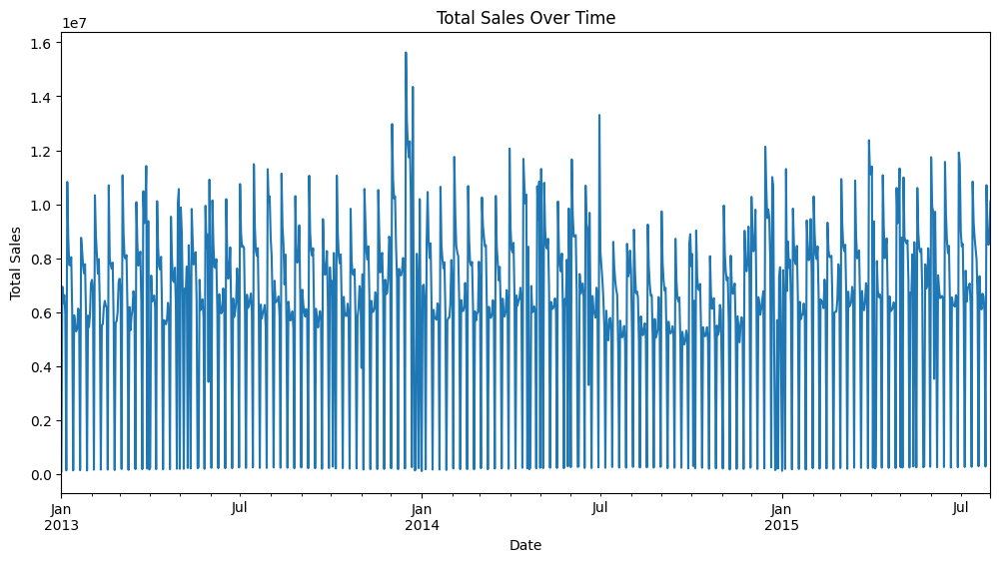

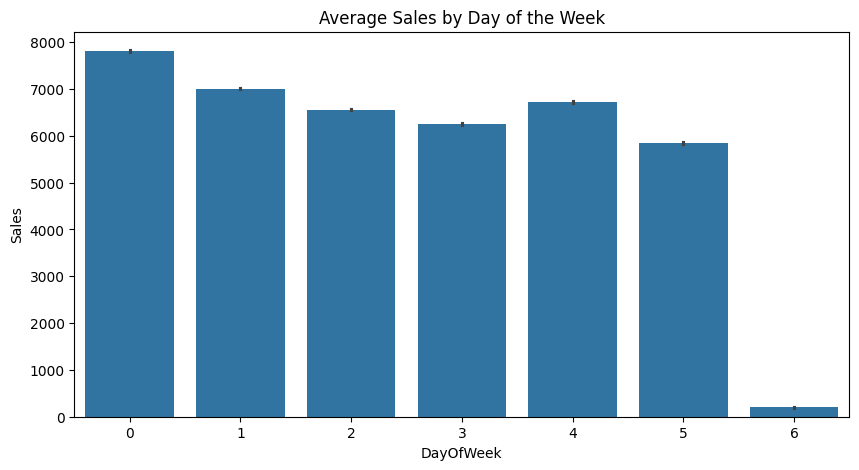

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import csv


# Load datasets
df_sales = pd.read_csv("/content/train.csv", on_bad_lines='skip', encoding="utf-8")

df_stores = pd.read_csv("/content/store.csv" , on_bad_lines='skip', encoding="utf-8")

# Merge sales & store data
df = df_sales.merge(df_stores, on="Store", how="left")

# Convert Date to datetime format
df["Date"] = pd.to_datetime(df["Date"])

# Show dataset info
print(df.info())
print(df.head())

# Fill missing values
df["CompetitionDistance"].fillna(df["CompetitionDistance"].median(), inplace=True)

# Convert categorical columns
df["StateHoliday"] = df["StateHoliday"].astype(str)

# Extract new time features
df["Year"] = df["Date"].dt.year
df["Month"] = df["Date"].dt.month
df["WeekOfYear"] = df["Date"].dt.isocalendar().week
df["DayOfWeek"] = df["Date"].dt.dayofweek
df["IsWeekend"] = df["DayOfWeek"].apply(lambda x: 1 if x >= 5 else 0)
df["IsHoliday"] = df["StateHoliday"].apply(lambda x: 1 if x in ["a", "b", "c"] else 0)


# Sales over time
plt.figure(figsize=(12,6))
df.groupby("Date")["Sales"].sum().plot()
plt.title("Total Sales Over Time")
plt.xlabel("Date")
plt.ylabel("Total Sales")
plt.show()

# Average sales by day of the week
plt.figure(figsize=(10,5))
sns.barplot(x="DayOfWeek", y="Sales", data=df)
plt.title("Average Sales by Day of the Week")
plt.show()


In [4]:
df = df.sort_values("Date")  # Make sure it's sorted
df["Sales_Lag1"] = df["Sales"].shift(1)

# Drop NA (first row has no lag)
df = df.dropna(subset=["Sales_Lag1"])

# Evaluation: RMSE
from sklearn.metrics import mean_squared_error
import numpy as np

rmse = np.sqrt(mean_squared_error(df["Sales"], df["Sales_Lag1"]))
print(f"Naive RMSE: {rmse:.2f}")


Naive RMSE: 3619.11


In [7]:
!pip install prophet


In [ ]:
!pip install statsmodels


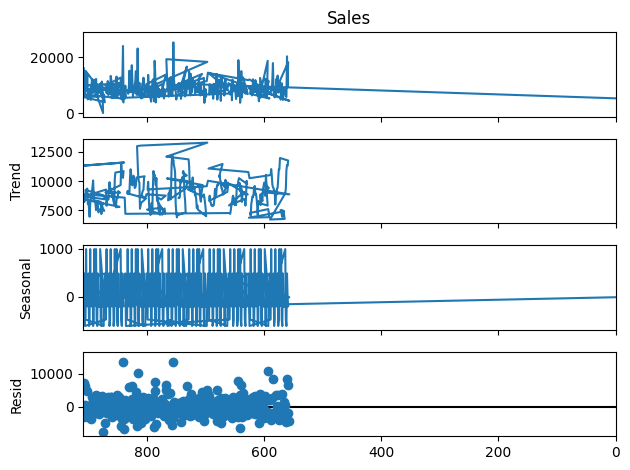

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.
  self._init_dates(dates, freq)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index

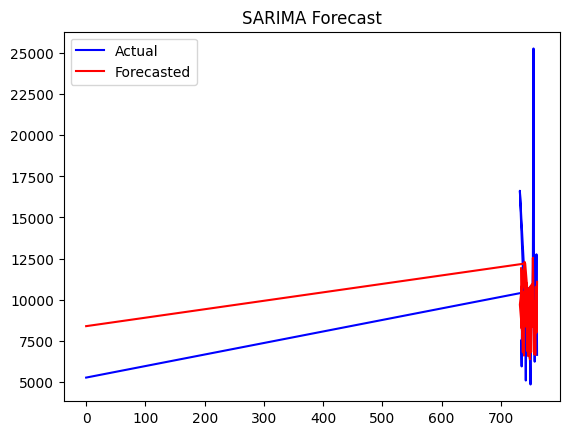

SARIMA RMSE: 4156.65


In [12]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import seasonal_decompose
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

# Use a subset of the data for faster computation (last 1000 rows)
df_subset = df.tail(500)

# Perform seasonal decomposition (only once for efficiency)
result = seasonal_decompose(df_subset["Sales"], model='additive', period=7)
result.plot()
plt.show()

# Use a simpler SARIMA model for faster fitting
train_data = df_subset["Sales"][:-30]  # Use all data except for the last 30 for training
test_data = df_subset["Sales"][-30:]   # Last 30 rows for testing

model = SARIMAX(train_data,
                order=(1,1,1),
                seasonal_order=(1,1,0,7))  # Simplified seasonal order
sarima_fit = model.fit(disp=False)  # Disable convergence warnings
sarima_forecast = sarima_fit.forecast(steps=30)

# Plot the forecasted values
plt.plot(test_data.index, test_data, label='Actual', color='blue')
plt.plot(test_data.index, sarima_forecast, label='Forecasted', color='red')
plt.title("SARIMA Forecast")
plt.legend()
plt.show()

# Calculate RMSE for the SARIMA model
rmse = np.sqrt(mean_squared_error(test_data, sarima_forecast))
print(f"SARIMA RMSE: {rmse:.2f}")


<ipython-input-14-a6ec81b6dce8>:16: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




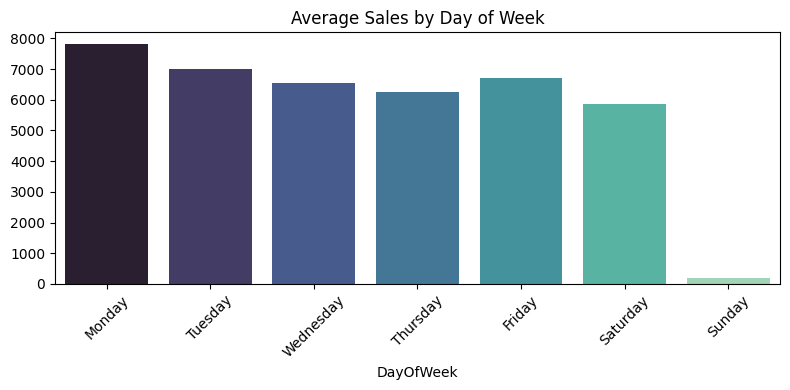

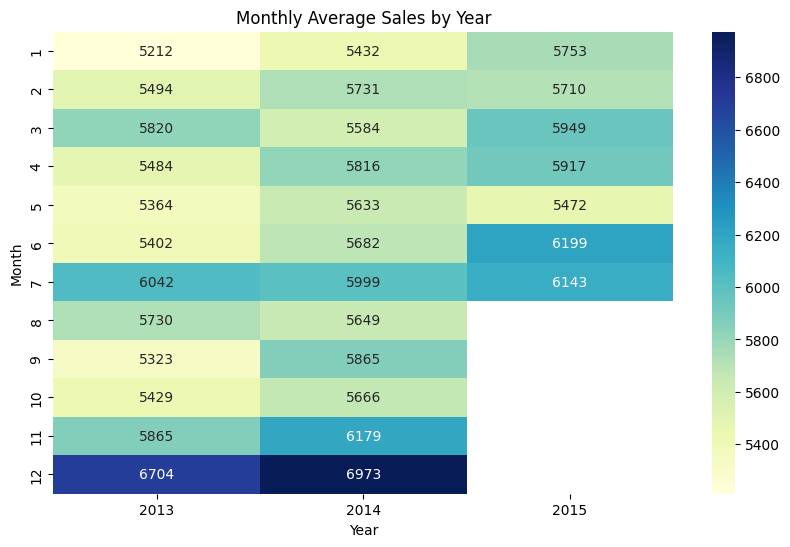

In [14]:
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# --- 1. Sales Over Time (Line Chart) ---
fig = px.line(df, x='Date', y='Sales', title='Sales Over Time', template='plotly_dark')
fig.show()

# --- 2. Sales by Day of Week ---
df["DayOfWeek"] = df["Date"].dt.day_name()
dow_avg = df.groupby("DayOfWeek")["Sales"].mean().reindex([
    "Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"
])

plt.figure(figsize=(8, 4))
sns.barplot(x=dow_avg.index, y=dow_avg.values, palette="mako")
plt.title("Average Sales by Day of Week")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# --- 3. Heatmap (Optional) ---
df["Month"] = df["Date"].dt.month
df["Year"] = df["Date"].dt.year
pivot = df.pivot_table(index="Month", columns="Year", values="Sales", aggfunc="mean")

plt.figure(figsize=(10, 6))
sns.heatmap(pivot, cmap="YlGnBu", annot=True, fmt=".0f")
plt.title("Monthly Average Sales by Year")
plt.show()


In [16]:
!pip install streamlit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.3/44.3 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.8/9.8 MB 38.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 52.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 5.4 MB/s eta 0:00:00


2025-04-16 16:37:01.549 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-04-16 16:37:01.563 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-04-16 16:37:01.807 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-04-16 16:37:01.816 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-04-16 16:37:01.822 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-04-16 16:37:01.825 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-04-16 16:37:01.826 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Dis

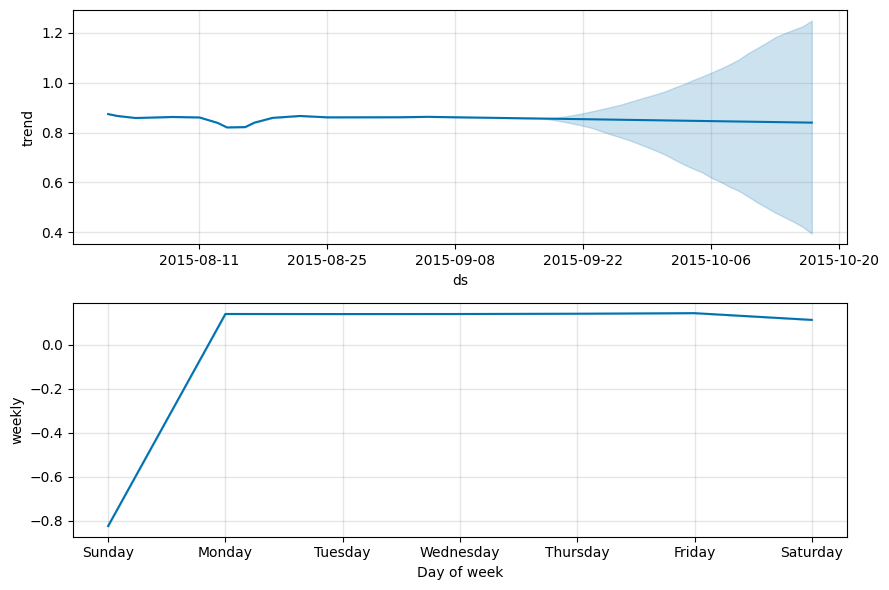

In [20]:
import streamlit as st
import pandas as pd
from prophet import Prophet
import plotly.express as px
import matplotlib.pyplot as plt

st.title("📈 Sales Forecasting App")

# Load data
df = pd.read_csv("/content/test.csv")
df["Date"] = pd.to_datetime(df["Date"])

# Replace 'Sales' with a valid column like 'Open'
df_prophet = df[["Date", "Open"]].rename(columns={"Date": "ds", "Open": "y"})

# Sidebar inputs
period = st.sidebar.slider("Forecast Period (days)", 7, 90, 30)

# Prophet model
m = Prophet()
m.fit(df_prophet)
future = m.make_future_dataframe(periods=period)
forecast = m.predict(future)

# Show forecast
fig = px.line(forecast, x="ds", y="yhat", title="Forecasted Open Stores")
st.plotly_chart(fig)

# Show components
st.subheader("Forecast Components")
comp_fig = m.plot_components(forecast)
st.pyplot(comp_fig)

# Raw data
if st.checkbox("Show raw data"):
    st.write(df.tail())
